In [1]:
%load_ext autoreload
%autoreload 2

import pymc as pm
import seaborn as sns
import pandas as pd
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import numpy as np
import arviz as az
from matplotlib import pyplot as plt

import sys
sys.path.append('..')
from pfas_prep import PFAS
from PyPKMC import PyPKMC
import register_pfas_data as rpd

In [2]:
chemical = 'PFHxS'
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv', route_only = 'gavage')#, hero_only=1289834) # 
Vdss_prior = {'mu': -1.5, 'sd': 1.5}
CLC_prior = {'mu': -2.89, 'sd': 2.68}
load_trace = True

# Rat fits

## Male

First import the data using the old PFAS class

In [3]:
%%time
pfas_male_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='rat')
pfas_male_data.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
dropping duplicated column
Hero ID used:  [3749289 4239569 5387170]
CPU times: user 444 ms, sys: 1.97 ms, total: 446 ms
Wall time: 447 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,3749289,17,-1,5,-1.0,NaN,0.324071,NaN,rat,sprague-dawley,4.0,mg/kg,1.0,day,10370.060700,0.000000,1,ng/ml,gavage,plasma,Male,DTXSID7040150,Figure 5C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,13,0,0,0,1.0,4.0,71.0,0.324071,10.370061,0.000000,0.0,-1,0,1,0,0.000000,2.338923,0.000000,False,1.296286,3749289-4.0 mg/kg-gavage
1,3749289,17,-1,5,-1.0,NaN,0.324071,NaN,rat,sprague-dawley,4.0,mg/kg,3.0,day,13071.180610,0.000000,1,ng/ml,gavage,plasma,Male,DTXSID7040150,Figure 5C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,13,0,0,0,3.0,4.0,73.0,0.329814,13.071181,0.000000,0.0,-1,0,1,0,0.000000,2.570410,0.000000,False,1.296286,3749289-4.0 mg/kg-gavage
2,3749289,17,-1,5,-1.0,NaN,0.324071,NaN,rat,sprague-dawley,4.0,mg/kg,4.0,day,13642.269060,0.000000,1,ng/ml,gavage,plasma,Male,DTXSID7040150,Figure 5C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,13,0,0,0,4.0,4.0,74.0,0.332686,13.642269,0.000000,0.0,-1,0,1,0,0.000000,2.613173,0.000000,False,1.296286,3749289-4.0 mg/kg-gavage
3,3749289,17,-1,5,-1.0,NaN,0.324071,NaN,rat,sprague-dawley,4.0,mg/kg,9.0,day,11190.197290,1095.266311,1,ng/ml,gavage,plasma,Male,DTXSID7040150,Figure 5C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,13,0,0,0,9.0,4.0,79.0,0.345729,11.190197,2.449090,0.0,-1,0,1,0,0.216305,2.391644,0.218860,False,1.296286,3749289-4.0 mg/kg-gavage
4,3749289,17,-1,5,-1.0,NaN,0.324071,NaN,rat,sprague-dawley,4.0,mg/kg,18.0,day,9575.842164,1156.871579,1,ng/ml,gavage,plasma,Male,DTXSID7040150,Figure 5C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,13,0,0,0,18.0,4.0,88.0,0.366800,9.575842,2.586843,0.0,-1,0,1,0,0.265400,2.224025,0.270143,False,1.296286,3749289-4.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [4]:
pfas_male_1cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro', trace_suffix='oral',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_rat_1cmpt_oral
hierarchical model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (39), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


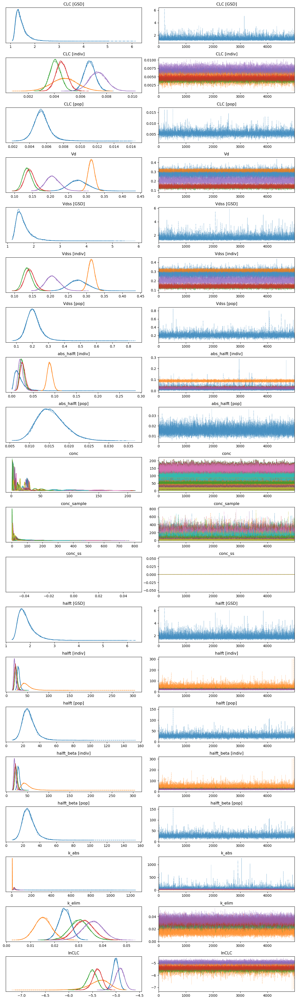

In [5]:
with pfas_male_1cmpt.model:
    az.plot_trace(pfas_male_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


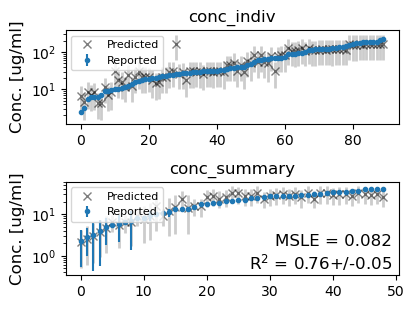

In [6]:
pfas_male_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [7]:
pfas_male_2cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro', trace_suffix='oral', # 0.1
                   load_trace=load_trace, tune=15000, draws=7000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_rat_2cmpt_oral
hierarchical model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (77), generating only 20 plots
  warnings.warn(


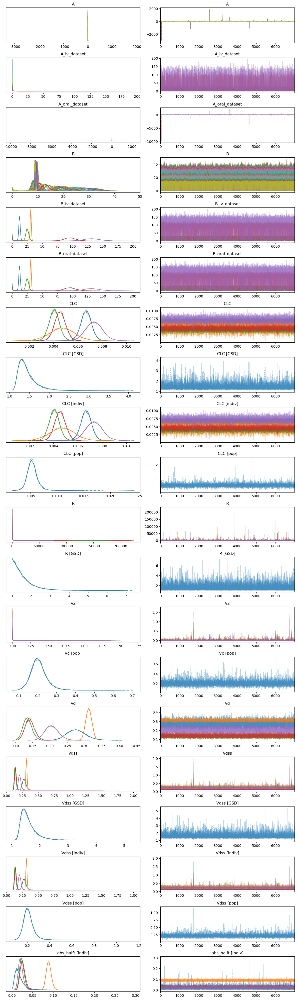

In [8]:
with pfas_male_2cmpt.model: # orig prior
    az.plot_trace(pfas_male_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


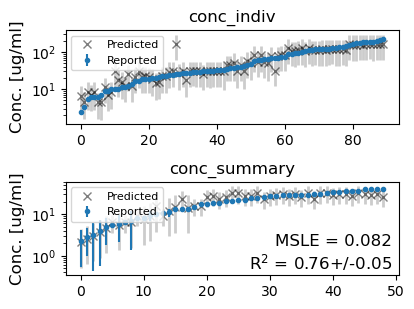

In [9]:
pfas_male_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
1_compartment,0,-1102.688681,33.879861,0.000000,1.000000e+00,69.292102,0.00000,True,log
2_compartment,1,-1103.037416,34.051677,0.348735,1.110223e-16,69.370823,0.19934,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

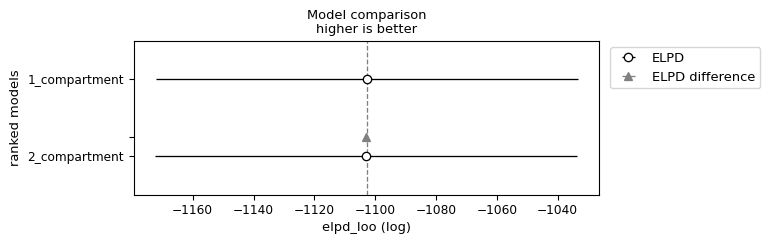

In [10]:
pfas_male_compare = az.compare({"1_compartment": pfas_male_1cmpt._trace, "2_compartment": pfas_male_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_male_compare)
az.plot_compare(pfas_male_compare, insample_dev=False)

#### Define winning model

In [11]:
pfas_male = pfas_male_1cmpt
print(pfas_male.N_divergences)
print(f'Pass all metrics = {pfas_male.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


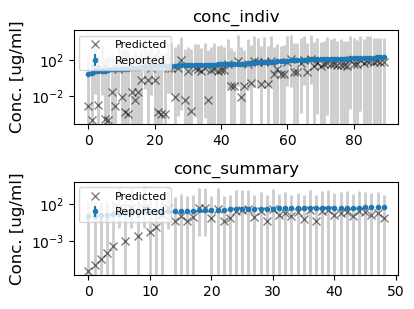

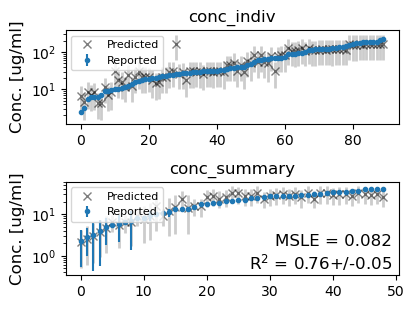

In [12]:
pfas_male.plot_data_ppc(group='prior', savefig=True)
pfas_male.plot_data_ppc(group='posterior', savefig=True)

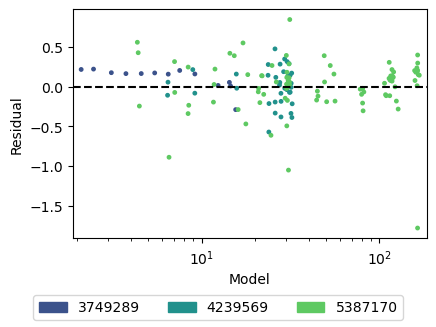

In [13]:
pfas_male.plot_residuals() 

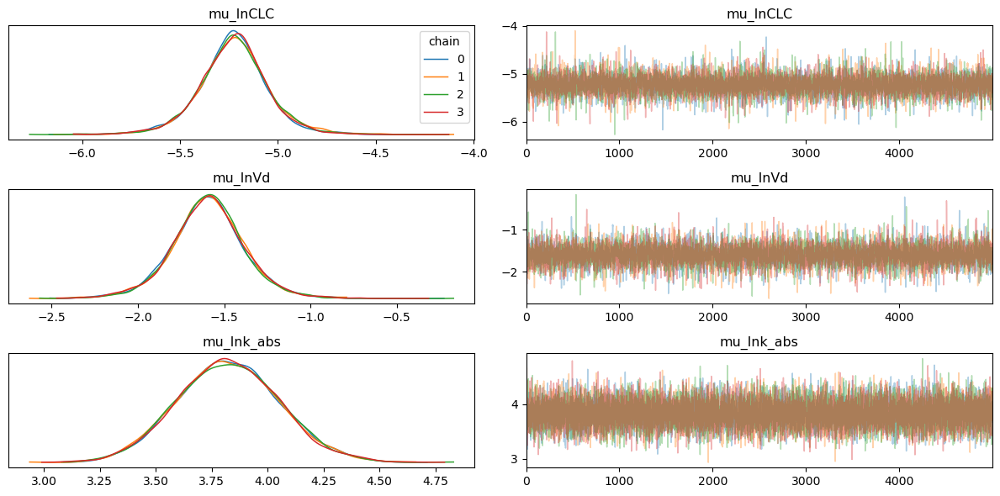

In [14]:
trace_model = pfas_male
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFHxS/PFHxS_Male_rat_CLC_1cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


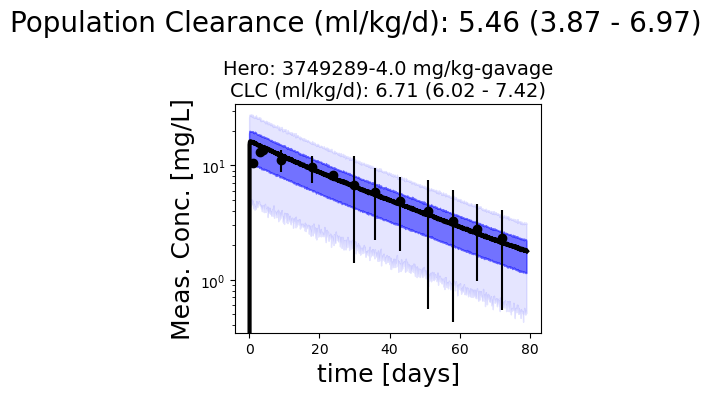

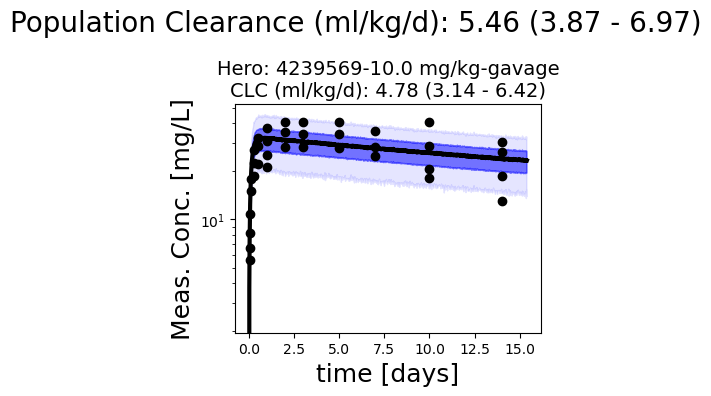

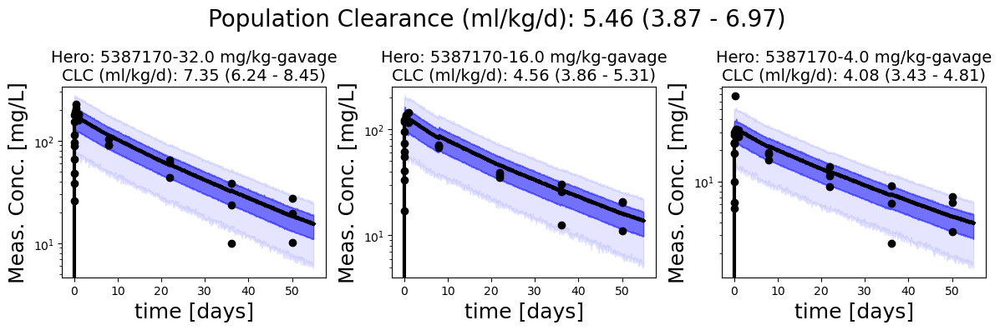

In [15]:
pfas_male.plot_all_studies()

### PK stats

In [16]:
#male_rat_draws = pfas_male.generate_samples(var_names = ['CLC [pop]', 'Vc [pop]', 'mu_k_dc', 'mu_k_cd', 'mu_k_abs'])#, 'mu_fa'])
male_rat_draws = pfas_male.generate_samples(var_names = ['CLC [pop]', 'Vdss [pop]', 'mu_k_abs'])#, 'mu_fa'])
male_rat_draws.to_csv('../posterior_pk/PFHxS_Male_Rat_20240820_oral.csv')

In [96]:
az.summary(pfas_male._trace, var_names = ['CLC [pop]', 'Vdss [pop]', 'mu_k_abs'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
CLC [pop],0.005,0.001,0.004,0.007,0.000,0.000,8046.0,10377.0,1.0
Vdss [pop],0.208,0.047,0.129,0.297,0.001,0.000,6996.0,9899.0,1.0
mu_k_abs,47.088,10.982,28.001,67.166,0.087,0.061,15365.0,15355.0,1.0


In [17]:
pfas_male.get_pk_stats(level='indiv', vol_units='ml', pk_stat='halft ')

,mean,sd,hdi_5%,hdi_95%
halft [indiv][3749289-4.0 mg/kg-gavage],28.89251,3.14060,23.95127,33.84220
halft [indiv][4239569-10.0 mg/kg-gavage],48.01137,12.99730,29.28804,64.71688
halft [indiv][5387170-4.0 mg/kg-gavage],23.33652,3.17728,18.57982,28.37952
halft [indiv][5387170-16.0 mg/kg-gavage],21.86018,2.84913,17.22847,26.06730
halft [indiv][5387170-32.0 mg/kg-gavage],19.58035,2.38726,15.81215,23.25484


In [18]:
pfas_male.get_pk_stats(vol_units='ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],5.46000,1.01000,3.87000,6.97000
Vdss [pop],208.22000,46.83000,136.33000,278.06000
abs_halft [pop],0.01550,0.00354,0.00996,0.02128
halft [pop],27.30246,8.08834,15.28349,39.19597
halft_beta [pop],27.30246,8.08834,15.28349,39.19597


## Female

In [19]:
%%time
pfas_female_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='rat')
pfas_female_data.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
dropping duplicated column
Hero ID used:  [3749289 4239569 5387170]
CPU times: user 449 ms, sys: 2.93 ms, total: 452 ms
Wall time: 452 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,3749289,18,-1,5,-1.0,NaN,0.213233,NaN,rat,sprague-dawley,4.0,mg/kg,0.5,hour,15568.75385,0.0,1,ng/ml,gavage,plasma,Female,DTXSID7040150,Figure 5C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,0,0,0,0.020833,4.0,70.020833,0.213233,15.568754,0.0,0.0,-1,0,1,1,0.0,2.745266,0.0,False,0.852933,3749289-4.0 mg/kg-gavage
1,3749289,18,-1,5,-1.0,NaN,0.213233,NaN,rat,sprague-dawley,4.0,mg/kg,1.0,hour,14213.51539,0.0,1,ng/ml,gavage,plasma,Female,DTXSID7040150,Figure 5C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,0,0,0,0.041667,4.0,70.041667,0.213267,14.213515,0.0,0.0,-1,0,1,1,0.0,2.654193,0.0,False,0.852933,3749289-4.0 mg/kg-gavage
2,3749289,18,-1,5,-1.0,NaN,0.213233,NaN,rat,sprague-dawley,4.0,mg/kg,2.0,hour,13192.85996,0.0,1,ng/ml,gavage,plasma,Female,DTXSID7040150,Figure 5C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,0,0,0,0.083333,4.0,70.083333,0.213333,13.192860,0.0,0.0,-1,0,1,1,0.0,2.579676,0.0,False,0.852933,3749289-4.0 mg/kg-gavage
3,3749289,18,-1,5,-1.0,NaN,0.213233,NaN,rat,sprague-dawley,4.0,mg/kg,4.0,hour,12502.92513,0.0,1,ng/ml,gavage,plasma,Female,DTXSID7040150,Figure 5C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,0,0,0,0.166667,4.0,70.166667,0.213467,12.502925,0.0,0.0,-1,0,1,1,0.0,2.525963,0.0,False,0.852933,3749289-4.0 mg/kg-gavage
4,3749289,18,-1,5,-1.0,NaN,0.213233,NaN,rat,sprague-dawley,4.0,mg/kg,6.0,hour,12078.41595,0.0,1,ng/ml,gavage,plasma,Female,DTXSID7040150,Figure 5C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,0,0,0,0.250000,4.0,70.250000,0.213600,12.078416,0.0,0.0,-1,0,1,1,0.0,2.491420,0.0,False,0.852933,3749289-4.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [20]:
pfas_female_1cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro', trace_suffix='oral',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Female_rat_1cmpt_oral
hierarchical model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (39), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


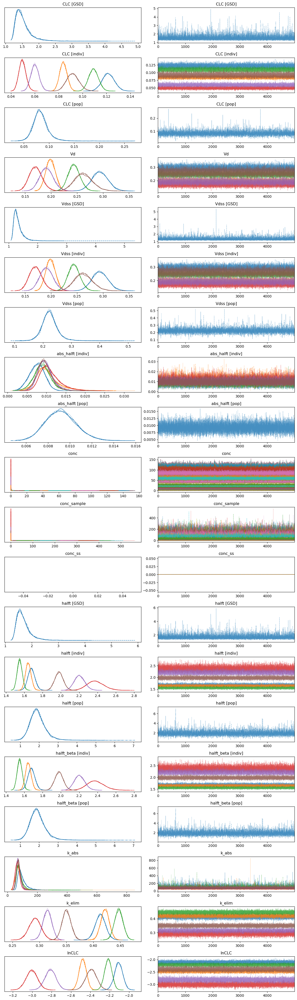

In [21]:
with pfas_female_1cmpt.model:
    az.plot_trace(pfas_female_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


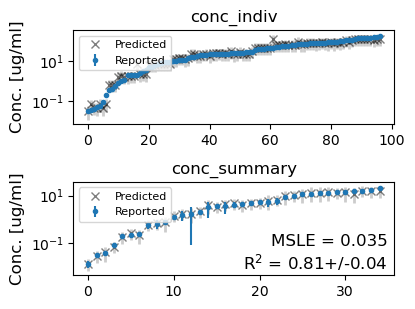

In [22]:
pfas_female_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [23]:
pfas_female_2cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro', random_seed=98765, trace_suffix='oral',
                   load_trace=load_trace, tune=15000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)


PFHxS_Female_rat_2cmpt_oral
hierarchical model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


Sampling: [conc_sample, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


Running PPC...
setting params...
sampling...
Calculating stats...


Sampling: [conc_sample, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


Running PPC...
setting params...
sampling...
Calculating stats...


Sampling: [conc_sample, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


Running PPC...
setting params...
sampling...
Calculating stats...


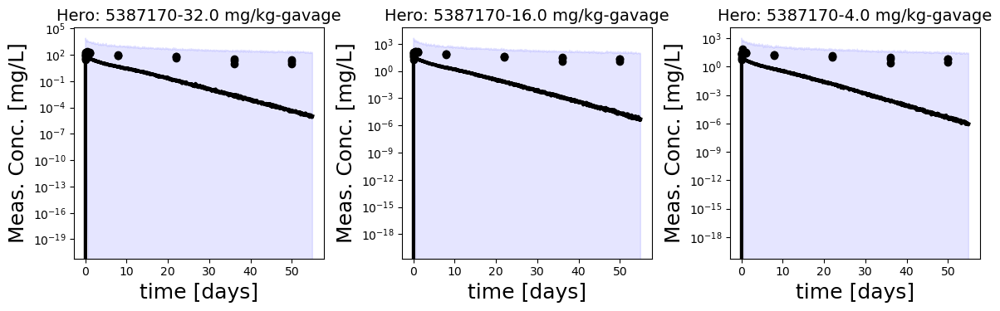

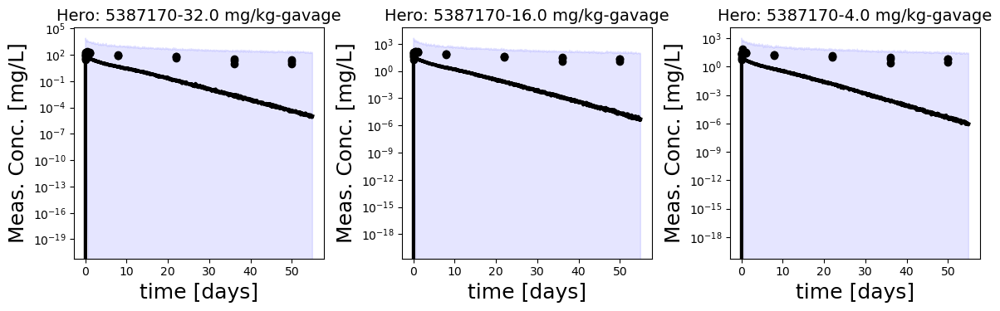

In [24]:
pfas_male_1cmpt._study_ppc(5387170, group='prior')

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (77), generating only 20 plots
  warnings.warn(


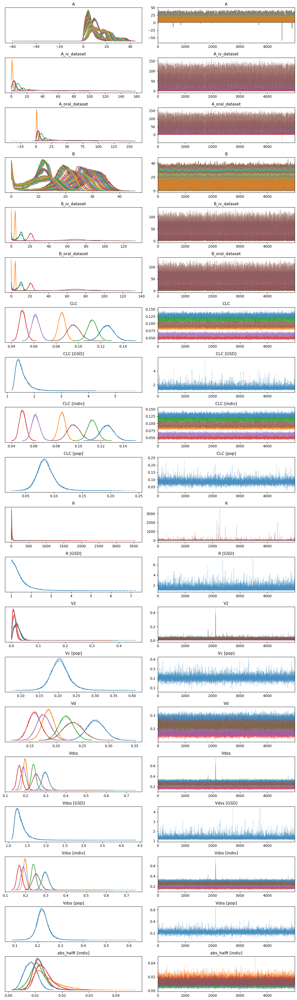

In [25]:
with pfas_female_2cmpt.model:
    az.plot_trace(pfas_female_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


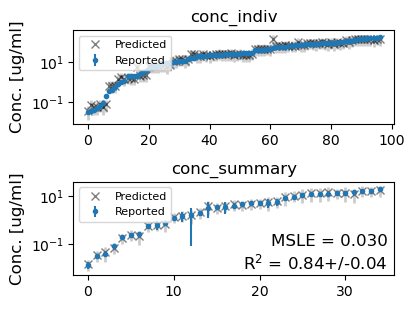

In [26]:
pfas_female_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-455.560854,39.461271,0.00000,0.864048,63.681145,0.000000,True,log
1_compartment,1,-464.464814,32.487139,8.90396,0.135952,65.417763,5.031895,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

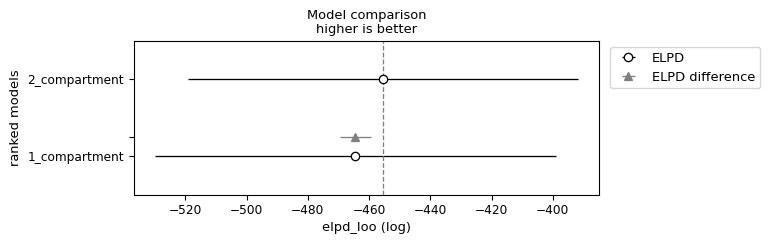

In [27]:
pfas_female_compare = az.compare({"1_compartment": pfas_female_1cmpt._trace, "2_compartment": pfas_female_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_female_compare)
az.plot_compare(pfas_female_compare, insample_dev=False)

#### Define winning model

In [28]:
pfas_female = pfas_female_2cmpt
print(pfas_female.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


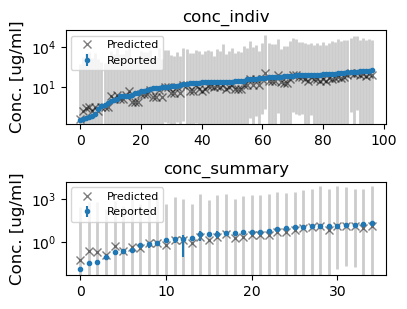

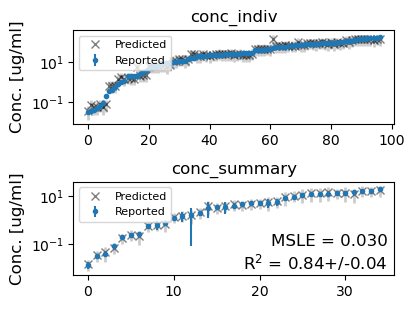

In [29]:
pfas_female.plot_data_ppc(group='prior', savefig=True)
pfas_female.plot_data_ppc(group='posterior', savefig=True)

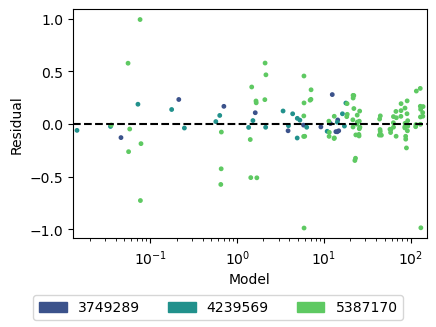

In [30]:
pfas_female.plot_residuals() 

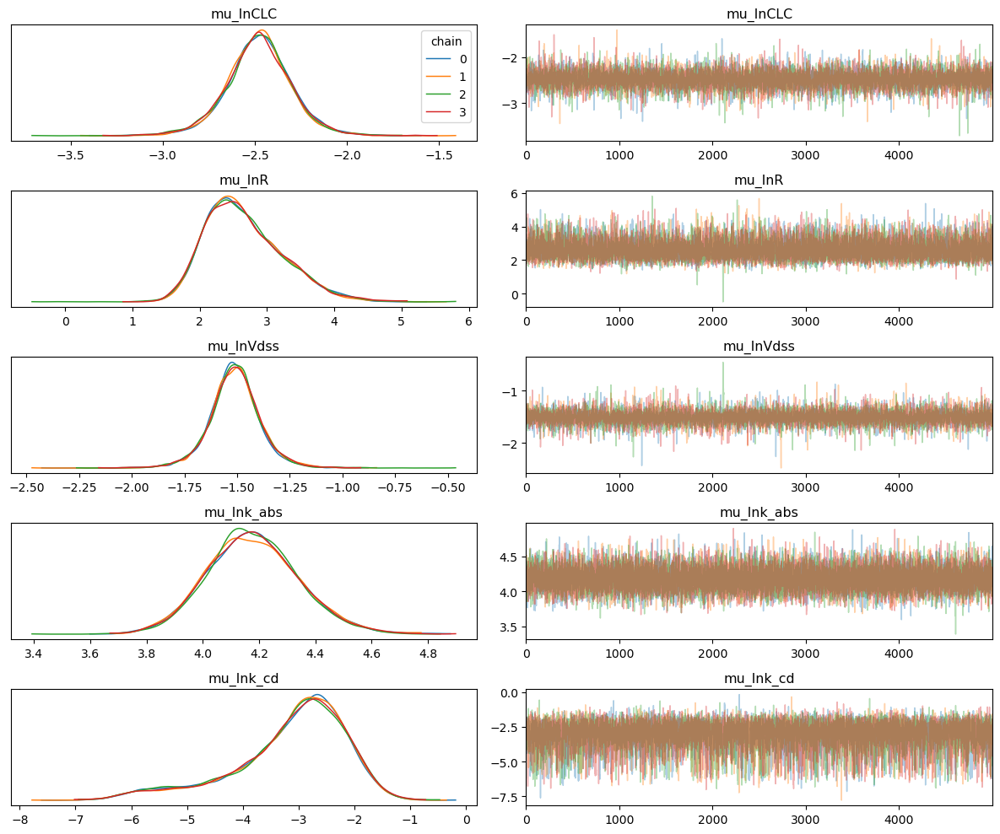

In [31]:
trace_model = pfas_female
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFHxS/PFHxS_Female_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


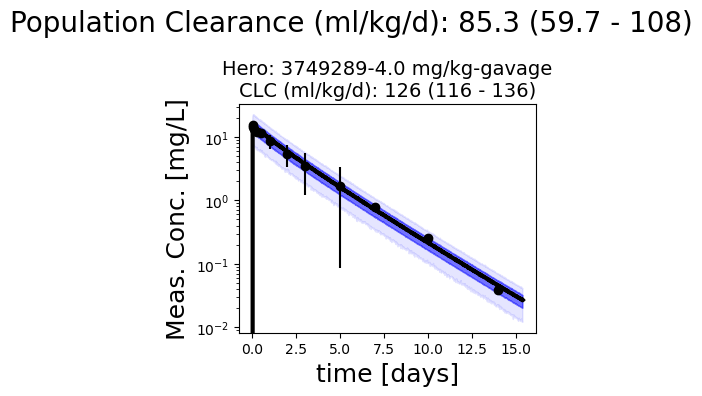

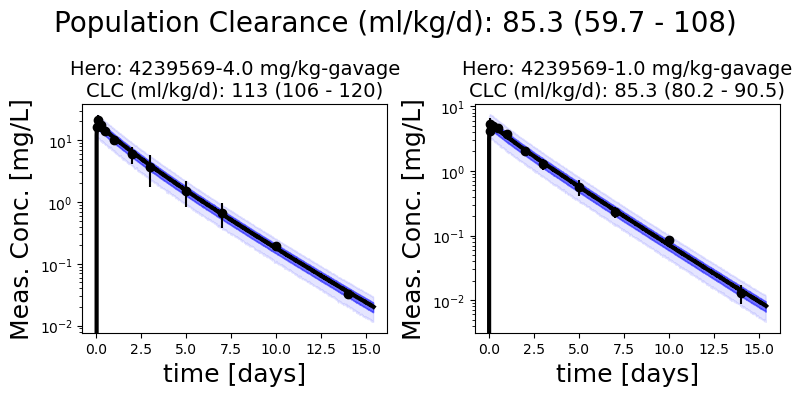

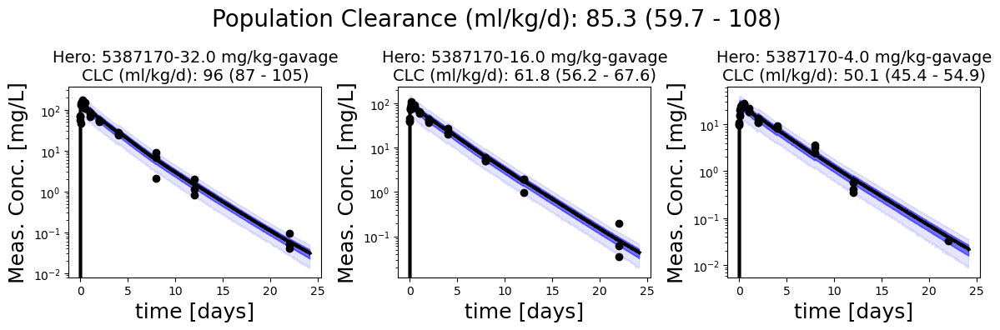

In [32]:
pfas_female.plot_all_studies()

### PK stats

In [33]:
female_rat_draws = pfas_female.generate_samples(var_names = ['CLC [pop]', 'Vc [pop]', 'mu_k_dc', 'mu_k_cd', 'mu_k_abs'])#, 'mu_fa'])
female_rat_draws.to_csv('../posterior_pk/PFHxS_Female_Rat_20240820_oral.csv')

In [98]:
az.summary(pfas_female._trace, var_names = ['CLC [pop]', 'Vc [pop]', 'mu_k_dc', 'mu_k_cd', 'mu_k_abs'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
CLC [pop],0.085,0.016,0.058,0.115,0.000,0.000,8181.0,10869.0,1.0
Vc [pop],0.206,0.026,0.158,0.256,0.000,0.000,9277.0,12164.0,1.0
mu_k_dc,0.741,0.480,0.014,1.400,0.004,0.003,7717.0,5118.0,1.0
mu_k_cd,0.064,0.051,0.001,0.151,0.000,0.000,7267.0,5569.0,1.0
mu_k_abs,66.210,11.080,46.236,86.599,0.077,0.056,21114.0,15820.0,1.0


In [34]:
pfas_female.get_pk_stats(level='indiv', vol_units='ml', pk_stat='Vdss')

,mean,sd,hdi_5%,hdi_95%
Vdss [indiv][3749289-4.0 mg/kg-gavage],299.16,17.73,271.79,326.82
Vdss [indiv][4239569-1.0 mg/kg-gavage],198.29,10.56,182.88,214.45
Vdss [indiv][4239569-4.0 mg/kg-gavage],240.55,12.66,221.00,259.05
Vdss [indiv][5387170-4.0 mg/kg-gavage],170.69,13.21,149.82,190.67
Vdss [indiv][5387170-16.0 mg/kg-gavage],190.80,13.53,169.98,212.66
Vdss [indiv][5387170-32.0 mg/kg-gavage],254.80,18.95,224.02,284.28


In [35]:
pfas_female.get_pk_stats(vol_units = 'ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],85.26000,15.55000,59.74000,107.97000
Vc [pop],0.20616,0.02618,0.16481,0.24679
Vdss [pop],222.63000,28.08000,177.78000,263.96000
abs_halft [pop],0.01075,0.00173,0.00800,0.01366
halft [pop],1.86930,0.42208,1.22039,2.50099
halft_alpha [pop],0.94461,0.41169,0.33073,1.59709
halft_beta [pop],2.50348,3.24708,1.31472,3.07930


# Mouse

## Male

In [36]:
%%time
pfas_male_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='mouse')
pfas_male_data_mouse.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
dropping duplicated column
Hero ID used:  [1289834]
CPU times: user 71.1 ms, sys: 1.01 ms, total: 72.1 ms
Wall time: 71.4 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289834,13,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,2.0,day,7.720572,0.209021,1,ug/ml,gavage,serum,Male,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,2.0,1.0,0.031,7.720572,0.418042,0.0,-1,0,1,0,0.054107,2.042425,0.054146,False,0.031,1289834-1.0 mg/kg-gavage
1,1289834,13,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,8.0,day,8.303630,0.352035,1,ug/ml,gavage,serum,Male,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,8.0,1.0,0.031,8.303630,0.704070,0.0,-1,0,1,0,0.084639,2.113111,0.084791,False,0.031,1289834-1.0 mg/kg-gavage
2,1289834,13,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,15.0,day,6.675468,0.000000,1,ug/ml,gavage,serum,Male,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,15.0,1.0,0.031,6.675468,0.000000,0.0,-1,0,1,0,0.000000,1.898439,0.000000,False,0.031,1289834-1.0 mg/kg-gavage
3,1289834,13,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,22.0,day,4.420242,0.242024,1,ug/ml,gavage,serum,Male,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,22.0,1.0,0.031,4.420242,0.484048,0.0,-1,0,1,0,0.109181,1.480234,0.109507,False,0.031,1289834-1.0 mg/kg-gavage
4,1289834,13,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,36.0,day,3.133113,0.330033,1,ug/ml,gavage,serum,Male,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,36.0,1.0,0.031,3.133113,0.660066,0.0,-1,0,1,0,0.208391,1.120314,0.210674,False,0.031,1289834-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [37]:
pfas_male_1cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_mouse_1cmpt
single level model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


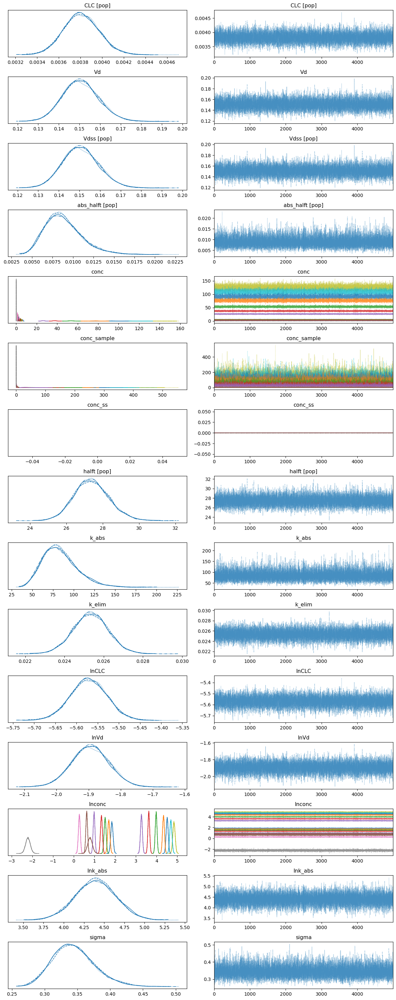

In [38]:
with pfas_male_1cmpt_mouse.model:
    az.plot_trace(pfas_male_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


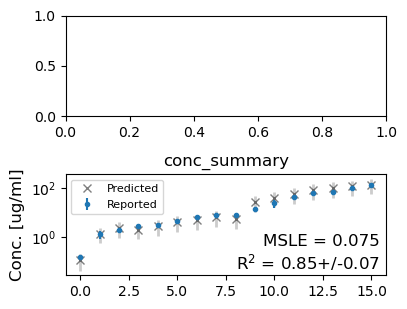

In [39]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [40]:
pfas_male_2cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=12000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_mouse_2cmpt
single level model, 2-compartment
Checking metrics...
Pass all metrics = False
Assign pareto...


/data/tzurlind/Desktop/PKWG/manuscript_code/animal_pfas_manuscript/pfas_notebooks/../PyPKMC.py:1025: UserWarning: There were 11 divergences after tuning. Increase `target_accept` or reparameterize.
  warnings.warn(msg)


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


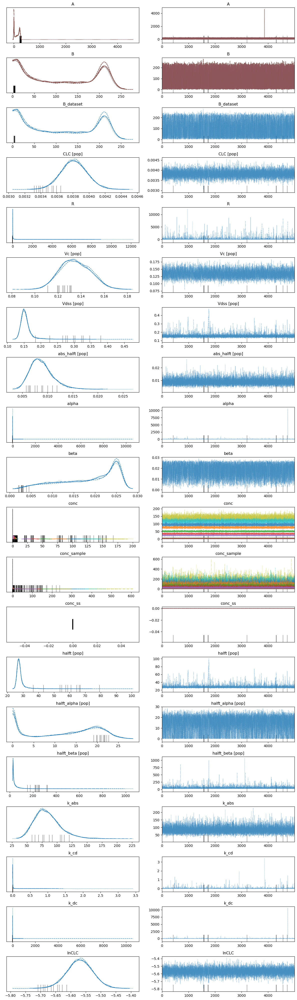

In [41]:
with pfas_male_2cmpt_mouse.model:
    az.plot_trace(pfas_male_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


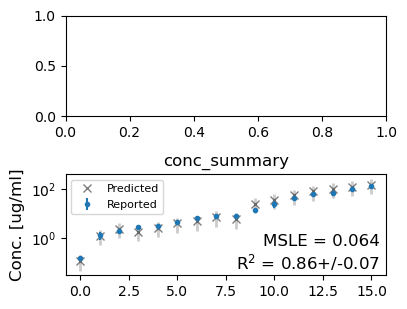

In [42]:
pfas_male_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
1_compartment,0,-171.794127,8.597280,0.000000,0.501479,27.246035,0.000000,True,log
2_compartment,1,-173.182968,15.052077,1.388841,0.498521,26.428039,3.858835,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

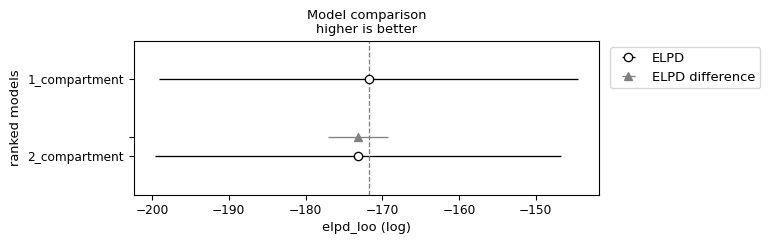

In [43]:
pfas_male_mouse_compare = az.compare({"1_compartment": pfas_male_1cmpt_mouse._trace, "2_compartment": pfas_male_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_male_mouse_compare)
az.plot_compare(pfas_male_mouse_compare, insample_dev=False)

#### Define winning model

In [44]:
pfas_male_mouse = pfas_male_1cmpt_mouse
print(pfas_male_mouse.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


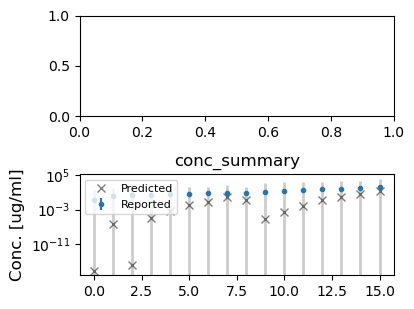

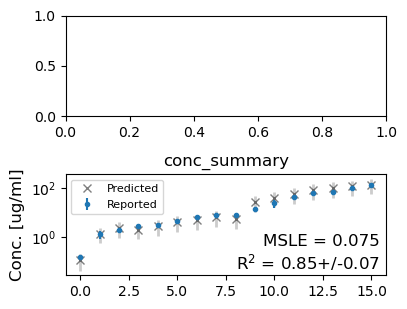

In [45]:
pfas_male_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_male_mouse.plot_data_ppc(group='posterior', savefig=True)

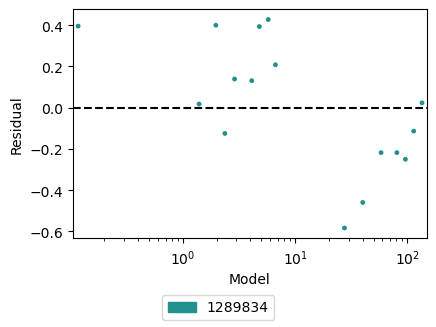

In [46]:
pfas_male_mouse.plot_residuals() 

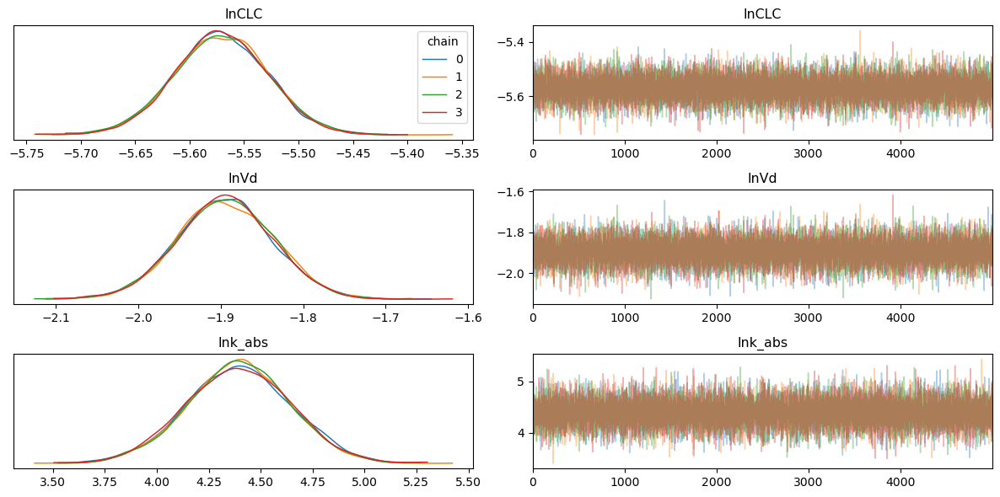

In [47]:
trace_model = pfas_male_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFHxS/PFHxS_Male_mouse_CLC_1cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


Sampling: [conc_sample]


Output()

Running PPC...
setting params...
sampling...


Calculating stats...


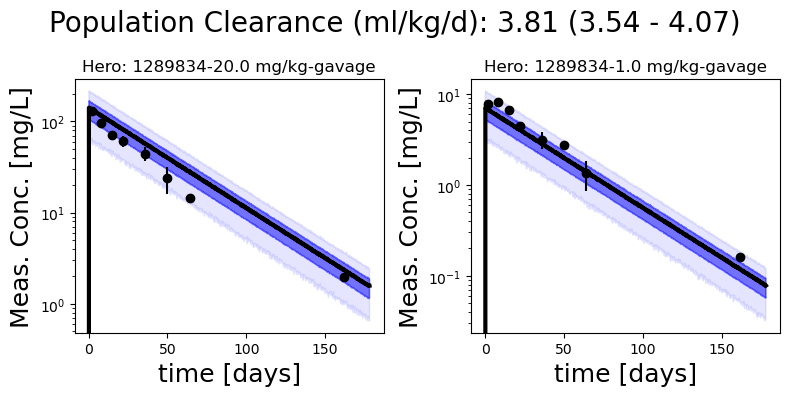

In [48]:
pfas_male_mouse.plot_all_studies()

### PK stats

In [49]:
#male_mouse_draws = pfas_male_mouse.generate_samples(var_names = ['CLC [pop]', 'Vdss [pop]', 'k_abs'])
#male_mouse_draws.to_csv('../posterior_pk/PFHxS_Male_Mouse_20240110.csv')

In [100]:
az.summary(pfas_male_mouse._trace, var_names = ['CLC [pop]', 'Vdss [pop]', 'k_abs'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
CLC [pop],0.004,0.000,0.003,0.004,0.000,0.000,17267.0,14629.0,1.0
Vdss [pop],0.151,0.009,0.134,0.167,0.000,0.000,17204.0,16049.0,1.0
k_abs,83.539,21.148,46.558,122.811,0.116,0.093,37627.0,13850.0,1.0


In [50]:
pfas_male_mouse.get_pk_stats(vol_units='ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],3.81000,0.16000,3.54000,4.08000
Vdss [pop],150.58000,8.75000,136.09000,164.66000
abs_halft [pop],0.00883,0.00224,0.00532,0.01233
halft [pop],27.39733,0.97178,25.82649,29.01623


## Female

In [51]:
%%time
pfas_female_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='mouse')
pfas_female_data_mouse.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
dropping duplicated column
Hero ID used:  [1289834]
CPU times: user 73.2 ms, sys: 0 ns, total: 73.2 ms
Wall time: 72.7 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289834,14,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,2.0,day,9.843784,0.715072,1,ug/ml,gavage,serum,Female,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,2.0,1.0,0.029,9.843784,1.430143,0.0,-1,0,1,1,0.144526,2.276396,0.145284,False,0.029,1289834-1.0 mg/kg-gavage
1,1289834,14,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,8.0,day,7.819582,0.319032,1,ug/ml,gavage,serum,Female,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,8.0,1.0,0.029,7.819582,0.638064,0.0,-1,0,1,1,0.081463,2.053313,0.081598,False,0.029,1289834-1.0 mg/kg-gavage
2,1289834,14,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,15.0,day,6.686469,0.000000,1,ug/ml,gavage,serum,Female,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,15.0,1.0,0.029,6.686469,0.000000,0.0,-1,0,1,1,0.000000,1.900086,0.000000,False,0.029,1289834-1.0 mg/kg-gavage
3,1289834,14,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,22.0,day,4.937294,0.264026,1,ug/ml,gavage,serum,Female,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,22.0,1.0,0.029,4.937294,0.528053,0.0,-1,0,1,1,0.106648,1.591130,0.106952,False,0.029,1289834-1.0 mg/kg-gavage
4,1289834,14,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,36.0,day,4.200220,0.198020,1,ug/ml,gavage,serum,Female,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,36.0,1.0,0.029,4.200220,0.396040,0.0,-1,0,1,1,0.094082,1.430711,0.094290,False,0.029,1289834-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [52]:
pfas_female_1cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Female_mouse_1cmpt
single level model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


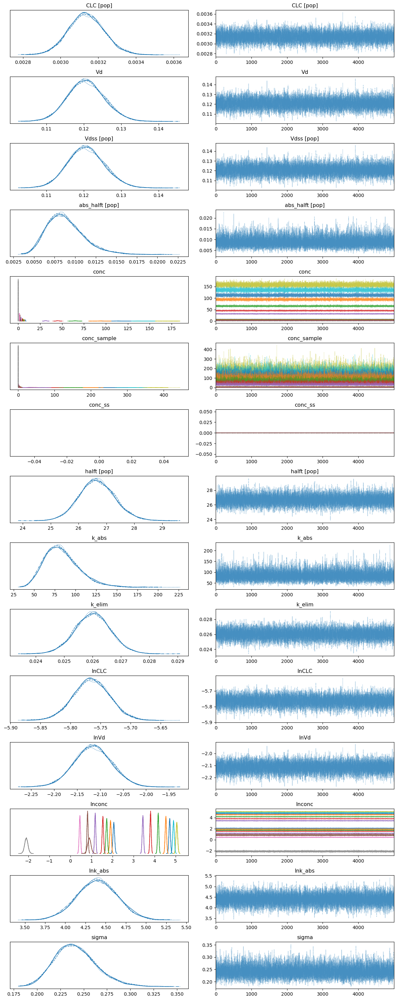

In [53]:
with pfas_female_1cmpt_mouse.model:
    az.plot_trace(pfas_female_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


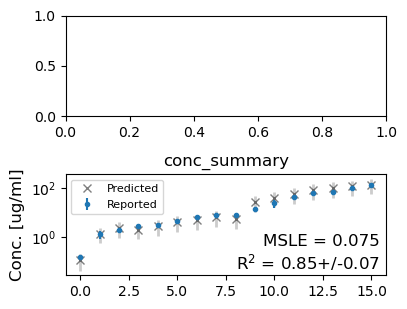

In [54]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [55]:
pfas_female_2cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=12000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Female_mouse_2cmpt
single level model, 2-compartment
Checking metrics...
Pass all metrics = False
Assign pareto...


/data/tzurlind/Desktop/PKWG/manuscript_code/animal_pfas_manuscript/pfas_notebooks/../PyPKMC.py:1025: UserWarning: There were 44 divergences after tuning. Increase `target_accept` or reparameterize.
  warnings.warn(msg)


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


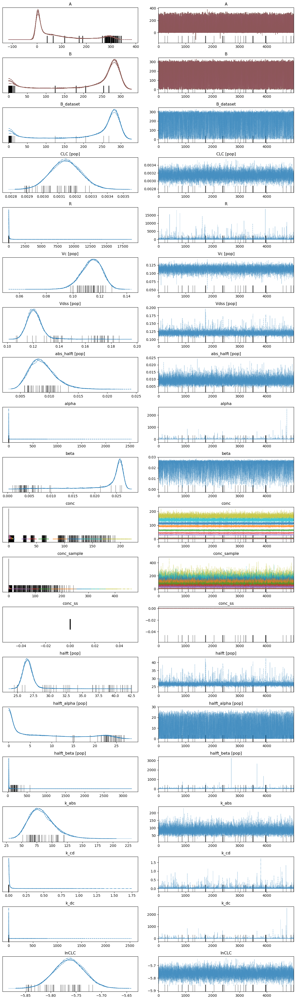

In [56]:
with pfas_female_2cmpt_mouse.model:
    az.plot_trace(pfas_female_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


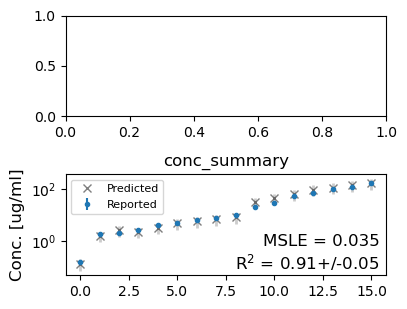

In [57]:
pfas_female_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
1_compartment,0,-161.456120,9.138182,0.000000,0.952667,28.924943,0.000000,True,log
2_compartment,1,-163.329017,14.070382,1.872896,0.047333,27.895909,2.192516,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

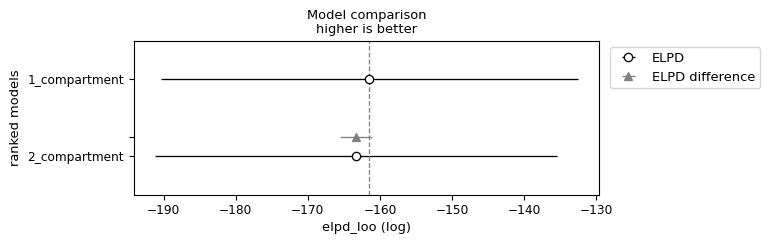

In [58]:
pfas_female_mouse_compare = az.compare({"1_compartment": pfas_female_1cmpt_mouse._trace, "2_compartment": pfas_female_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_female_mouse_compare)
az.plot_compare(pfas_female_mouse_compare, insample_dev=False)

#### Define winning model

In [59]:
pfas_female_mouse = pfas_female_1cmpt_mouse
print(pfas_female_mouse.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


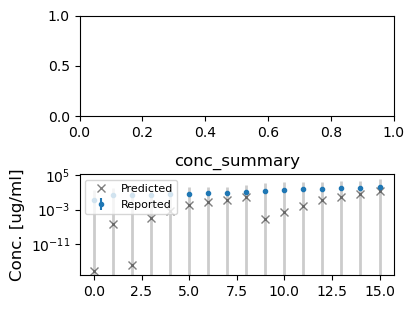

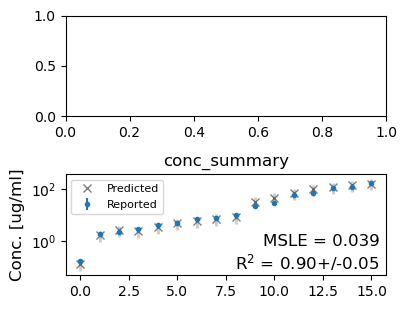

In [60]:
pfas_female_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_female_mouse.plot_data_ppc(group='posterior', savefig=True)

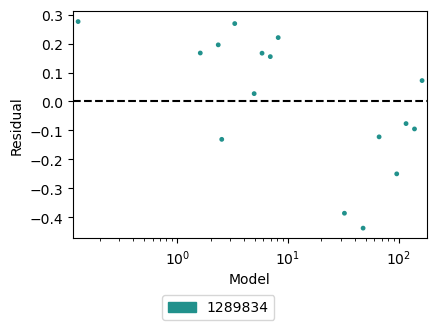

In [61]:
pfas_female_mouse.plot_residuals() 

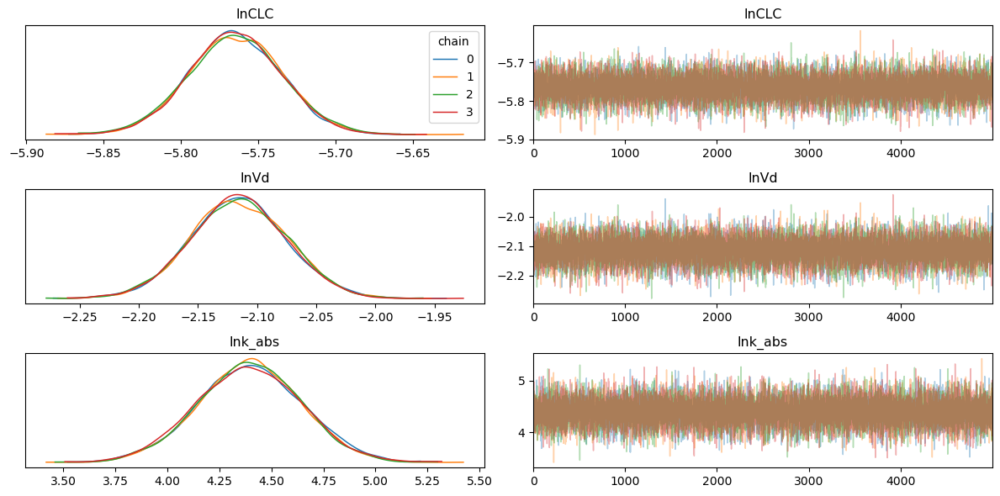

In [62]:
trace_model = pfas_female_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFHxS/PFHxS_Female_mouse_CLC_1cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


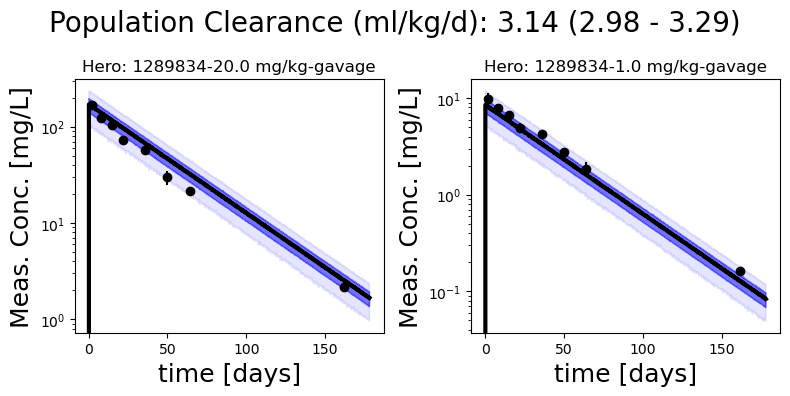

In [63]:
pfas_female_mouse.plot_all_studies()

### PK stats

In [64]:
#female_mouse_draws = pfas_female_mouse.generate_samples(var_names = ['CLC [pop]', 'Vdss [pop]', 'k_abs'])
#female_mouse_draws.to_csv('../posterior_pk/PFHxS_Female_Mouse_20240110.csv')

In [104]:
az.summary(pfas_female_mouse._trace, var_names = ['CLC [pop]', 'Vdss [pop]', 'k_abs'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
CLC [pop],0.003,0.000,0.003,0.003,0.000,0.000,17167.0,14263.0,1.0
Vdss [pop],0.121,0.005,0.111,0.130,0.000,0.000,17044.0,15513.0,1.0
k_abs,83.580,21.158,46.847,122.946,0.116,0.093,38479.0,14244.0,1.0


In [65]:
pfas_female_mouse.get_pk_stats(vol_units='ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],3.14000,0.10000,2.98000,3.29000
Vdss [pop],120.66000,4.92000,112.77000,128.90000
abs_halft [pop],0.00882,0.00223,0.00531,0.01230
halft [pop],26.66512,0.64078,25.57065,27.68071


# Primate

## Male

In [66]:
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')#, hero_only=1289834) #

In [67]:
%%time
pfas_male_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='primate')
pfas_male_data_primate.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
dropping duplicated column
Hero ID used:  [1289834]
CPU times: user 74.8 ms, sys: 2.03 ms, total: 76.8 ms
Wall time: 76.3 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289834,15,1,1,6.009063,kg,6.009063,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,212.400044,0.0,0,ug/ml,iv,serum,Male,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,6.009063,212.400044,0.0,0.0,-1,0,0,0,0.0,5.358471,0.0,True,60.090634,1289834-10.0 mg/kg-iv
1,1289834,15,2,1,6.202417,kg,6.202417,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,157.016736,0.0,0,ug/ml,iv,serum,Male,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,6.202417,157.016736,0.0,0.0,-1,0,0,0,0.0,5.056352,0.0,True,62.024169,1289834-10.0 mg/kg-iv
2,1289834,15,3,1,5.404834,kg,5.404834,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,175.252853,0.0,0,ug/ml,iv,serum,Male,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,5.404834,175.252853,0.0,0.0,-1,0,0,0,0.0,5.166230,0.0,True,54.048338,1289834-10.0 mg/kg-iv
3,1289834,15,1,1,6.009063,kg,6.009063,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,126.236448,0.0,0,ug/ml,iv,serum,Male,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.083333,10.0,6.009063,126.236448,0.0,0.0,-1,0,0,0,0.0,4.838157,0.0,True,60.090634,1289834-10.0 mg/kg-iv
4,1289834,15,2,1,6.202417,kg,6.202417,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,139.723762,0.0,0,ug/ml,iv,serum,Male,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.083333,10.0,6.202417,139.723762,0.0,0.0,-1,0,0,0,0.0,4.939667,0.0,True,62.024169,1289834-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [68]:
pfas_male_1cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_primate_1cmpt
single level model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


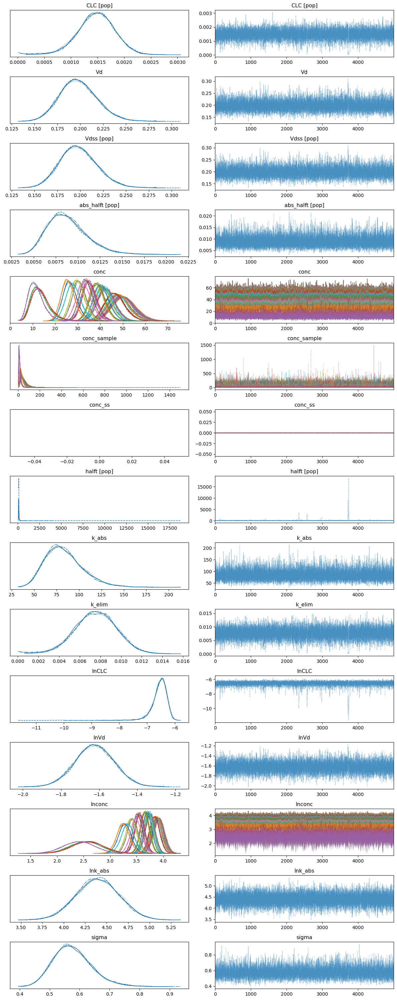

In [69]:
with pfas_male_1cmpt_primate.model:
    az.plot_trace(pfas_male_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


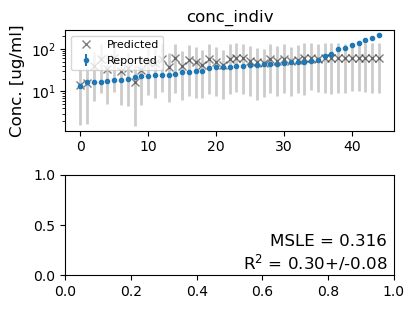

In [70]:
pfas_male_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [71]:
pfas_male_2cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_primate_2cmpt
single level model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


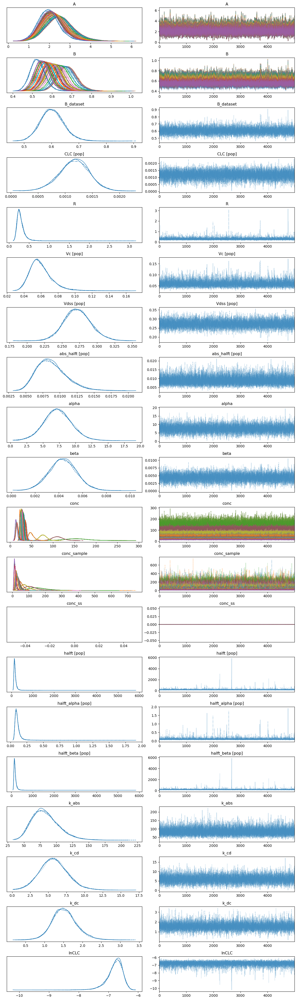

In [72]:
with pfas_male_2cmpt_primate.model:
    az.plot_trace(pfas_male_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


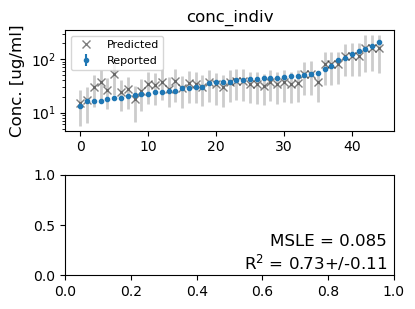

In [73]:
pfas_male_2cmpt_primate.plot_data_ppc(group='posterior')

conc_indiv
conc_summary


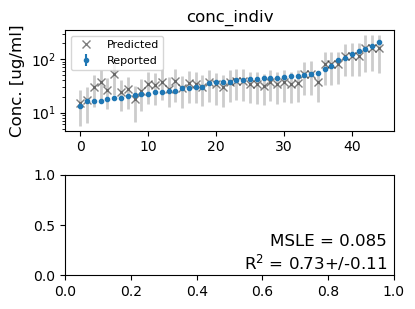

In [74]:
pfas_male_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-180.540764,5.004514,0.000000,0.961427,7.038545,0.00000,False,log
1_compartment,1,-205.870799,2.805820,25.330035,0.038573,8.386939,6.71093,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

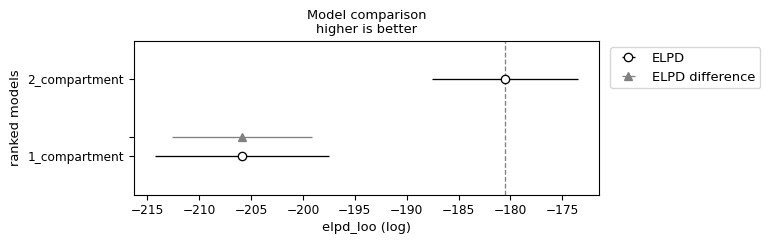

In [75]:
pfas_male_primate_compare = az.compare({"1_compartment": pfas_male_1cmpt_primate._trace, "2_compartment": pfas_male_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_male_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [76]:
pfas_male_primate = pfas_male_2cmpt_primate
print(pfas_male_primate.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


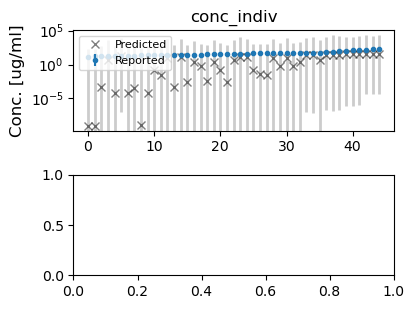

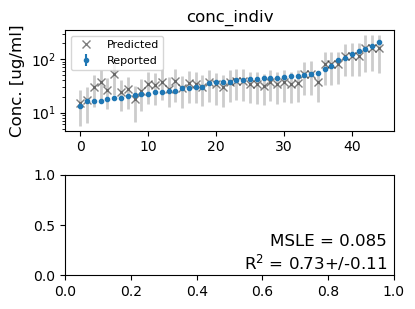

In [77]:
pfas_male_primate.plot_data_ppc(group='prior', savefig=True)
pfas_male_primate.plot_data_ppc(group='posterior', savefig=True)

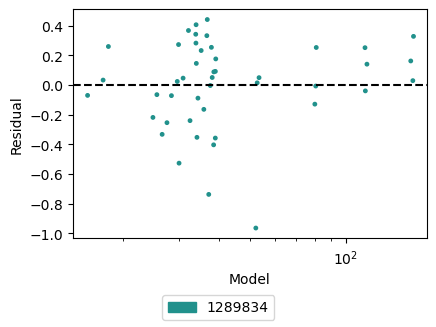

In [78]:
pfas_male_primate.plot_residuals() 

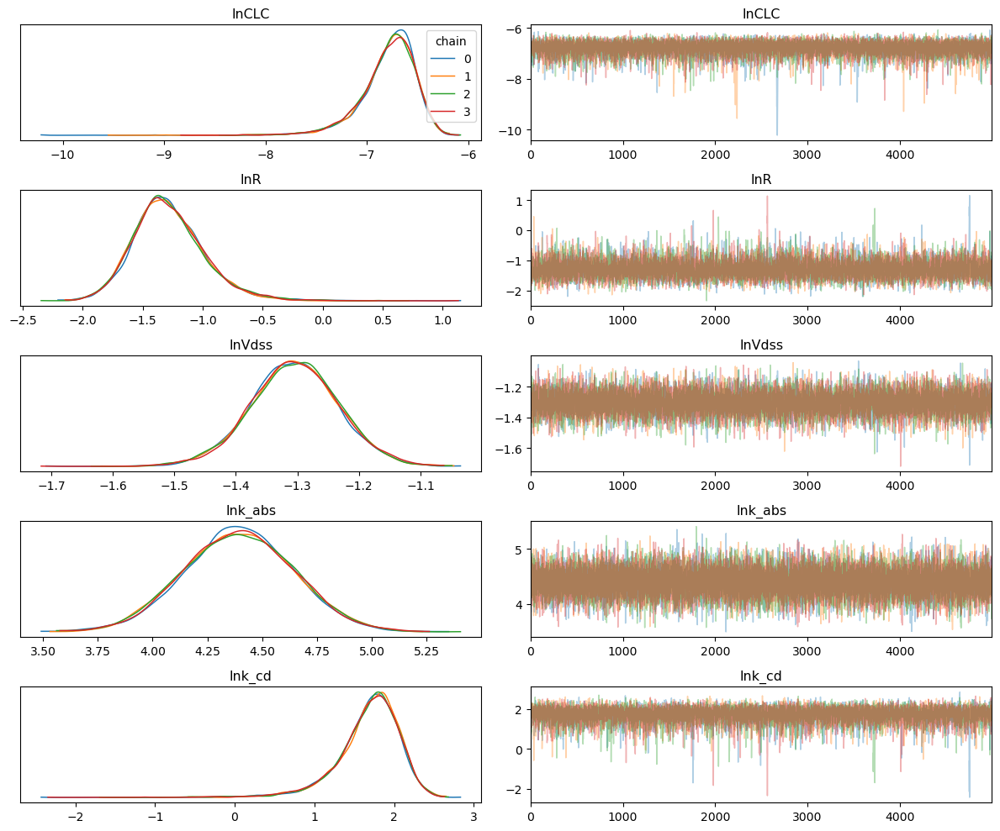

In [79]:
trace_model = pfas_male_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFHxS/PFHxS_Male_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


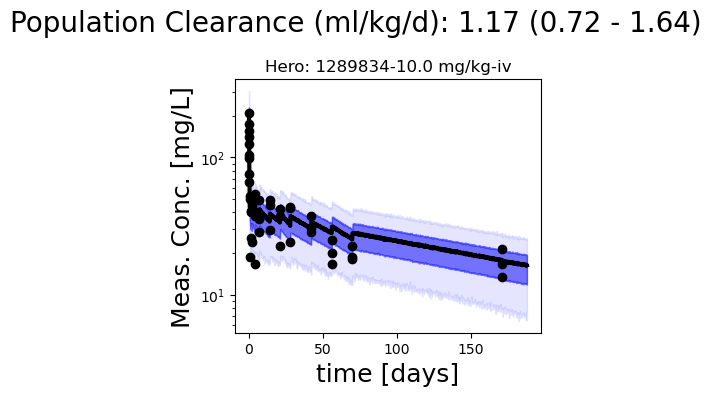

In [80]:
pfas_male_primate.plot_all_studies()#hero_unity=[1289834])

### PK stats

In [105]:
az.summary(pfas_male_primate._trace, var_names = ['CLC [pop]', 'Vc [pop]', 'k_dc', 'k_cd', 'k_abs'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
CLC [pop],0.001,0.000,0.001,0.002,0.000,0.000,13473.0,10251.0,1.0
Vc [pop],0.060,0.014,0.037,0.084,0.000,0.000,8824.0,8467.0,1.0
k_dc,1.531,0.344,0.901,2.201,0.003,0.002,14345.0,10035.0,1.0
k_cd,5.751,1.943,2.046,9.370,0.020,0.014,9214.0,7555.0,1.0
k_abs,83.486,21.048,47.650,123.681,0.128,0.098,29140.0,14164.0,1.0


In [81]:
pfas_male_primate.get_pk_stats(vol_units='ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],1.17000,0.28000,0.72000,1.64000
Vc [pop],0.05987,0.01362,0.03982,0.08063
Vdss [pop],272.01000,19.47000,239.31000,303.19000
abs_halft [pop],0.00883,0.00223,0.00537,0.01236
halft [pop],177.64128,104.24792,95.53627,250.63121
halft_alpha [pop],0.10740,0.06051,0.05323,0.15401
halft_beta [pop],178.01308,104.26789,95.92423,251.12281


## Female

In [82]:
%%time
pfas_female_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='primate')
pfas_female_data_primate.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
dropping duplicated column
Hero ID used:  [1289834]
CPU times: user 73.4 ms, sys: 2.95 ms, total: 76.3 ms
Wall time: 75.8 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289834,16,4,1,3.604230,kg,3.604230,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,186.591427,0.0,0,ug/ml,iv,serum,Female,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,3.604230,186.591427,0.0,0.0,-1,0,0,1,0.0,5.228921,0.0,True,36.042296,1289834-10.0 mg/kg-iv
1,1289834,16,5,1,3.725076,kg,3.725076,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,217.972037,0.0,0,ug/ml,iv,serum,Female,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,3.725076,217.972037,0.0,0.0,-1,0,0,1,0.0,5.384367,0.0,True,37.250755,1289834-10.0 mg/kg-iv
2,1289834,16,6,1,4.111782,kg,4.111782,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,145.574845,0.0,0,ug/ml,iv,serum,Female,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,4.111782,145.574845,0.0,0.0,-1,0,0,1,0.0,4.980690,0.0,True,41.117825,1289834-10.0 mg/kg-iv
3,1289834,16,4,1,3.604230,kg,3.604230,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,156.654510,0.0,0,ug/ml,iv,serum,Female,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.083333,10.0,3.604230,156.654510,0.0,0.0,-1,0,0,1,0.0,5.054043,0.0,True,36.042296,1289834-10.0 mg/kg-iv
4,1289834,16,5,1,3.725076,kg,3.725076,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,174.760647,0.0,0,ug/ml,iv,serum,Female,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.083333,10.0,3.725076,174.760647,0.0,0.0,-1,0,0,1,0.0,5.163417,0.0,True,37.250755,1289834-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [83]:
pfas_female_1cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Female_primate_1cmpt
single level model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


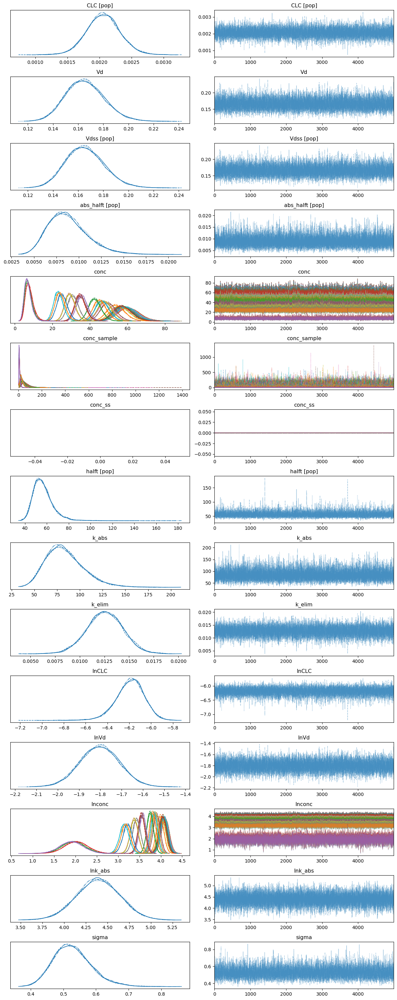

In [84]:
with pfas_female_1cmpt_primate.model:
    az.plot_trace(pfas_female_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


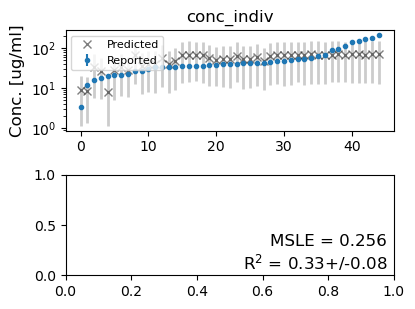

In [85]:
pfas_female_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [86]:
pfas_female_2cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.999, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=15000, draws=7000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Female_primate_2cmpt
single level model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


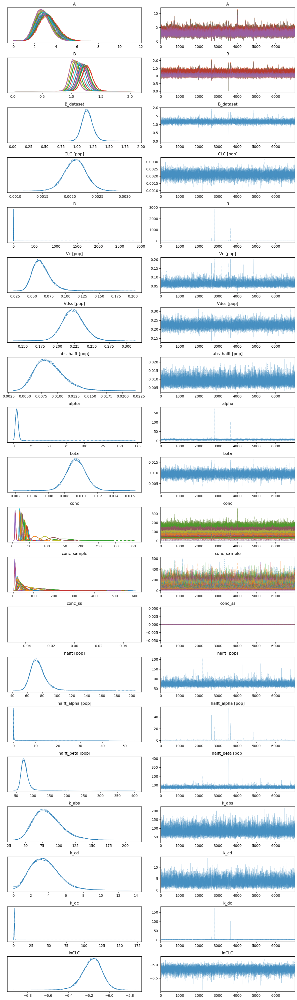

In [87]:
with pfas_female_2cmpt_primate.model:
    az.plot_trace(pfas_female_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


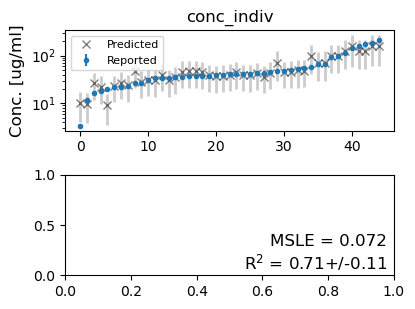

In [88]:
pfas_female_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-187.928957,12.978536,0.000000,0.919578,10.773598,0.000000,True,log
1_compartment,1,-206.422178,4.617365,18.493221,0.080422,8.548641,10.416303,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

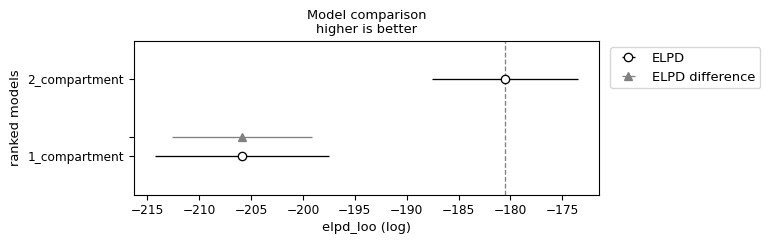

In [89]:
pfas_female_primate_compare = az.compare({"1_compartment": pfas_female_1cmpt_primate._trace, "2_compartment": pfas_female_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_female_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [90]:
pfas_female_primate = pfas_female_2cmpt_primate
print(pfas_female_primate.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


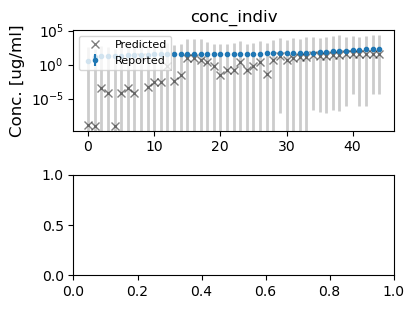

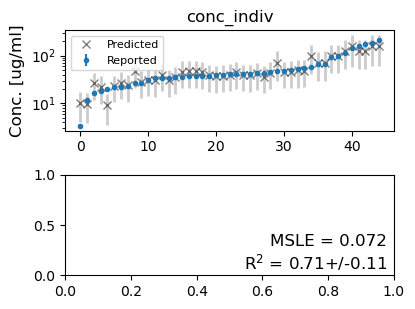

In [91]:
pfas_female_primate.plot_data_ppc(group='prior', savefig=True)
pfas_female_primate.plot_data_ppc(group='posterior', savefig=True)

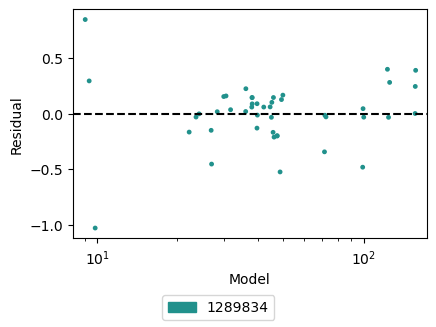

In [92]:
pfas_female_primate.plot_residuals() 

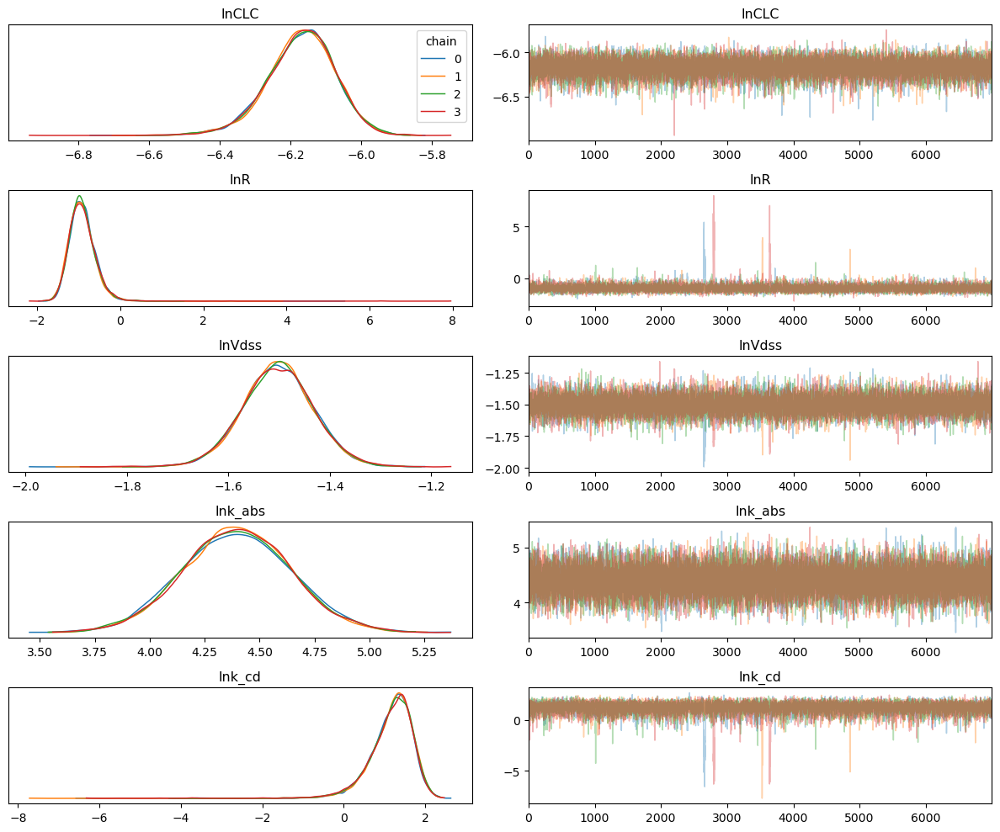

In [93]:
trace_model = pfas_female_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFHxS/PFHxS_Female_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


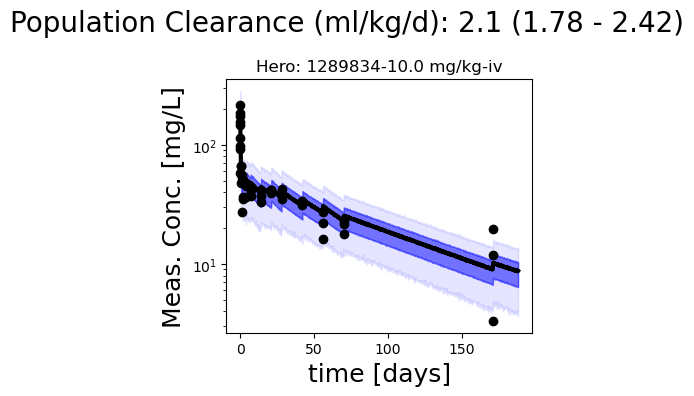

In [94]:
pfas_female_primate.plot_all_studies()#hero_unity=[1289834])

### PK stats

In [106]:
az.summary(pfas_female_primate._trace, var_names = ['CLC [pop]', 'Vc [pop]', 'k_dc', 'k_cd', 'k_abs'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
CLC [pop],0.002,0.000,0.002,0.002,0.000,0.000,19596.0,17815.0,1.0
Vc [pop],0.064,0.014,0.042,0.089,0.000,0.000,8367.0,6660.0,1.0
k_dc,1.361,1.265,0.580,2.101,0.008,0.005,14272.0,9967.0,1.0
k_cd,3.593,1.600,0.779,6.574,0.016,0.011,8383.0,6993.0,1.0
k_abs,83.647,21.049,47.609,123.651,0.109,0.085,40812.0,20471.0,1.0


In [95]:
pfas_female_primate.get_pk_stats(vol_units='ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],2.10000,0.20000,1.78000,2.42000
Vc [pop],0.06449,0.01404,0.04429,0.08523
Vdss [pop],222.93000,15.78000,197.94000,249.02000
abs_halft [pop],0.00881,0.00220,0.00524,0.01219
halft [pop],74.37645,9.72865,59.08024,88.91603
halft_alpha [pop],0.18644,0.63975,0.06624,0.27555
halft_beta [pop],74.79621,9.98740,59.46196,89.41088
